# LFW Face Generation and Latent Attribute Editing

In this notebook, I built an end-to-end workflow for face reconstruction and semantic latent editing on the LFW dataset. I kept the core model setup stable and focused on making each stage interpretable through structured analysis and visual diagnostics.


## 1. Autoencoder Fundamentals

![Autoencoder Concept](Autoencoder.svg)

At the beginning of this project, I introduced the basic idea of an autoencoder: the encoder compresses a face image into a compact latent vector, and the decoder reconstructs the image from that representation.

In this notebook, I optimize reconstruction quality with **MSE loss** and I report **SSIM** as an additional structural-quality metric during analysis.


## 2. Variational Autoencoders and Key Differences

![AE vs VAE](VAE_vs_AE.svg)

I also explained how a VAE differs conceptually from a deterministic autoencoder.

- In a standard autoencoder, the latent code is deterministic.
- In a VAE, the model learns a latent distribution (`mu`, `logvar`) and samples from it.

I included this comparison to clarify why latent regularization matters for generative smoothness, even though the main implementation here follows a deterministic dense autoencoder pipeline.


## 3. Imports and Environment

In this section, I set up the full Python environment for preprocessing, visualization, and model training. I also fixed random seeds so the experimental behavior is reproducible.


In [24]:
import matplotlib.pyplot as plt
import seaborn as sns
import os
import glob
import pandas as pd
import random
import numpy as np
import cv2
import imageio.v2 as imageio
import torch
import torch.nn as nn
import torch.nn.functional as F
from tqdm.notebook import tqdm
from PIL import Image
from sklearn.model_selection import train_test_split

# Optional metric
try:
    from skimage.metrics import structural_similarity as ssim
    HAS_SSIM = True
except Exception:
    HAS_SSIM = False

SEED = 42
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)

DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print('Training on', DEVICE)
print('SSIM available:', HAS_SSIM)
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.linear_model import LogisticRegression

# Global plotting style (presentation only)
sns.set_theme(style='whitegrid', context='notebook')
plt.rcParams['figure.dpi'] = 120
plt.rcParams['axes.titleweight'] = 'bold'
plt.rcParams['axes.labelsize'] = 10


Training on cuda
SSIM available: True


## 4. Data Paths

Here I define the dataset paths used across all stages: image loading, metadata alignment, training, and evaluation.


In [25]:
DATASET_PATH = "/kaggle/input/lfw-dataset/lfw-deepfunneled/lfw-deepfunneled/"
ATTRIBUTES_PATH = "/kaggle/input/datasets/shaikabdussattar/labelled-faces-in-the-wild-lfw-dataset/lfw_attributes.txt"


## 5. Data Discovery and Exploratory Analysis

Before training the model, I performed an exploratory review of the dataset. I inspected identity frequencies and random face samples to understand class imbalance, image variety, and general data quality.


In [26]:
dataset = []
for path in glob.iglob(os.path.join(DATASET_PATH, "**", "*.jpg"), recursive=True):
    person = path.split("/")[-2]
    dataset.append({"person": person, "path": path})

dataset = pd.DataFrame(dataset)
# Frequency filtering to reduce dominance from very high-count identities.
dataset = dataset.groupby("person").filter(lambda x: len(x) < 25)

print('Images after frequency filter:', len(dataset))
print('Unique identities:', dataset['person'].nunique())
dataset.head(10)


Images after frequency filter: 10645
Unique identities: 5707


,person,path
0,Tyler_Hamilton,/kaggle/input/lfw-dataset/lfw-deepfunneled/lfw...
1,Tyler_Hamilton,/kaggle/input/lfw-dataset/lfw-deepfunneled/lfw...
2,Bernard_Siegel,/kaggle/input/lfw-dataset/lfw-deepfunneled/lfw...
3,Blythe_Danner,/kaggle/input/lfw-dataset/lfw-deepfunneled/lfw...
4,Blythe_Danner,/kaggle/input/lfw-dataset/lfw-deepfunneled/lfw...
5,Gene_Robinson,/kaggle/input/lfw-dataset/lfw-deepfunneled/lfw...
6,Gene_Robinson,/kaggle/input/lfw-dataset/lfw-deepfunneled/lfw...
7,Gene_Robinson,/kaggle/input/lfw-dataset/lfw-deepfunneled/lfw...
8,Gene_Robinson,/kaggle/input/lfw-dataset/lfw-deepfunneled/lfw...
9,Gene_Robinson,/kaggle/input/lfw-dataset/lfw-deepfunneled/lfw...


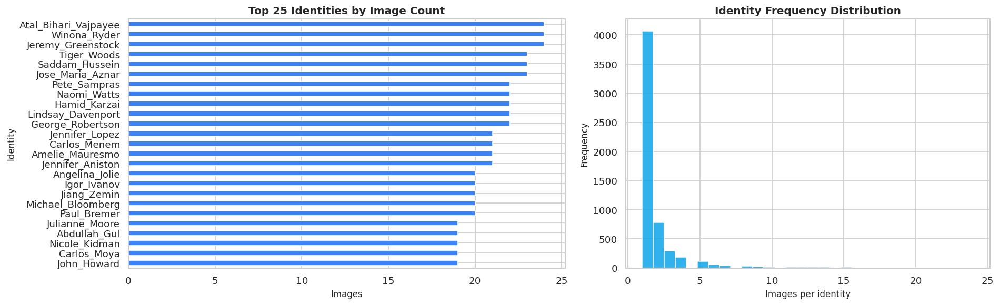

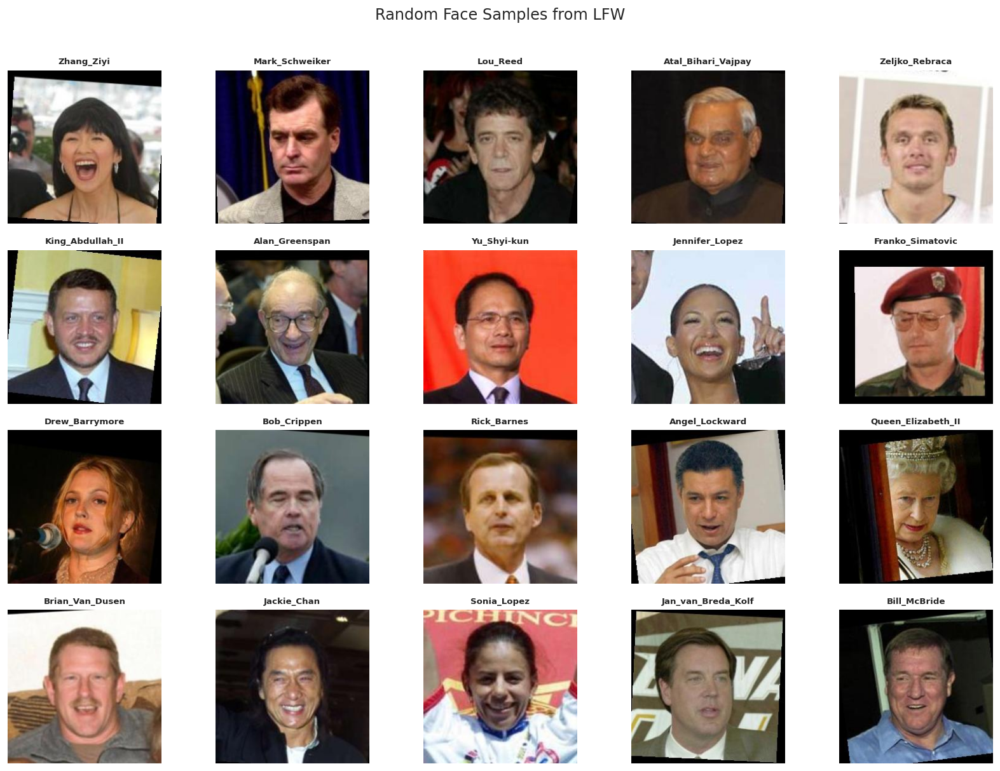

In [27]:
identity_counts = dataset.groupby("person").count()['path'].sort_values(ascending=False)

fig, axes = plt.subplots(1, 2, figsize=(16, 5), gridspec_kw={'width_ratios': [1.2, 1]})
identity_counts.head(25).sort_values().plot(kind='barh', ax=axes[0], color='#3b82f6')
axes[0].set_title('Top 25 Identities by Image Count')
axes[0].set_xlabel('Images')
axes[0].set_ylabel('Identity')

axes[1].hist(identity_counts.values, bins=30, color='#0ea5e9', alpha=0.85)
axes[1].set_title('Identity Frequency Distribution')
axes[1].set_xlabel('Images per identity')
axes[1].set_ylabel('Frequency')

plt.tight_layout()
plt.show()

fig, axes = plt.subplots(4, 5, figsize=(14, 10))
for i, ax in enumerate(axes.flatten()):
    idx = random.randint(0, len(dataset) - 1)
    img = plt.imread(dataset.path.iloc[idx])
    ax.imshow(img)
    ax.set_title(dataset.person.iloc[idx][:18], fontsize=8)
    ax.axis('off')
plt.suptitle('Random Face Samples from LFW', y=1.01)
plt.tight_layout()
plt.show()


## 6. Attribute-Aligned Dataset Construction

In this stage, I aligned image files with attribute records using `(person, imagenum)`. After alignment, I applied face-region cropping, resized all images to `45x45`, normalized to `[0, 1]`, and created train/validation splits for modeling.


In [28]:
def fetch_dataset(dx=80, dy=80, dimx=45, dimy=45):
    df_attrs = pd.read_csv(ATTRIBUTES_PATH, sep='	', skiprows=1)
    df_attrs = pd.DataFrame(df_attrs.iloc[:, :-1].values, columns=df_attrs.columns[1:])

    photo_ids = []
    for dirpath, _, filenames in os.walk(DATASET_PATH):
        for fname in filenames:
            if fname.endswith('.jpg'):
                fpath = os.path.join(dirpath, fname)
                photo_id = fname[:-4].replace('_', ' ').split()
                person_id = ' '.join(photo_id[:-1])
                photo_number = int(photo_id[-1])
                photo_ids.append({'person': person_id, 'imagenum': photo_number, 'photo_path': fpath})

    photo_ids = pd.DataFrame(photo_ids)
    df = pd.merge(df_attrs, photo_ids, on=('person', 'imagenum'))

    assert len(df) == len(df_attrs), 'Lost some rows while merging dataframes.'

    all_photos = (
        df['photo_path']
        .apply(imageio.imread)
        .apply(lambda img: img[dy:-dy, dx:-dx])
        .apply(lambda img: np.array(Image.fromarray(img).resize([dimx, dimy])))
    )

    all_photos = np.stack(all_photos.values).astype('uint8')
    all_attrs = df.drop(["photo_path", "person", "imagenum"], axis=1)

    return all_photos, all_attrs


data, attrs = fetch_dataset()
print('Image tensor shape:', data.shape)
print('Attributes shape:', attrs.shape)
attrs.head()


Image tensor shape: (13143, 45, 45, 3)
Attributes shape: (13143, 73)


,Male,Asian,White,Black,Baby,Child,Youth,Middle Aged,Senior,Black Hair,...,Pale Skin,5 o' Clock Shadow,Strong Nose-Mouth Lines,Wearing Lipstick,Flushed Face,High Cheekbones,Brown Eyes,Wearing Earrings,Wearing Necktie,Wearing Necklace
0,1.568346,-1.889043,1.737203,-0.929729,-1.471799,-0.19558,-0.835609,-0.351468,-1.012533,-0.719593,...,0.361738,1.166118,-1.164916,-1.13999,-2.371746,-1.299932,-0.414682,-1.144902,0.694007,-0.826609
1,0.169851,-0.982408,0.422709,-1.282184,-1.36006,-0.867002,-0.452293,-0.197521,-0.956073,-0.802107,...,-0.832036,-0.39768,0.87416,-0.945431,-0.268649,-0.006244,-0.030406,-0.480128,0.66676,-0.496559
2,0.997749,-1.364195,-0.157377,-0.756447,-1.891825,-0.871526,-0.862893,0.031445,-1.341523,-0.090037,...,1.549743,1.884745,-0.999765,-1.359858,-1.912108,-1.095634,0.915126,-0.572332,0.144262,-0.841231
3,1.122719,-1.997799,1.916144,-2.514214,-2.580071,-1.404239,0.057551,0.000196,-1.273512,-1.431462,...,0.567822,-0.176089,1.108125,-1.600944,-3.264613,0.813418,0.308631,-0.848693,0.475941,-0.447025
4,1.078214,-2.008098,1.676211,-2.278056,-2.651845,-1.348408,0.649089,0.017656,-1.889111,-1.857213,...,-1.461474,-0.955283,0.119113,-1.128176,-3.161048,0.08268,-0.439614,-0.359859,-0.760774,-0.410152


In [29]:
# Core dimensions from processed images
IMAGE_H = data.shape[1]
IMAGE_W = data.shape[2]
N_CHANNELS = 3

# Normalize and split
data = np.array(data / 255.0, dtype='float32')
X_train, X_val = train_test_split(data, test_size=0.2, random_state=42)

X_train = torch.FloatTensor(X_train)
X_val = torch.FloatTensor(X_val)

print('Train:', tuple(X_train.shape), '| Val:', tuple(X_val.shape))


Train: (10514, 45, 45, 3) | Val: (2629, 45, 45, 3)


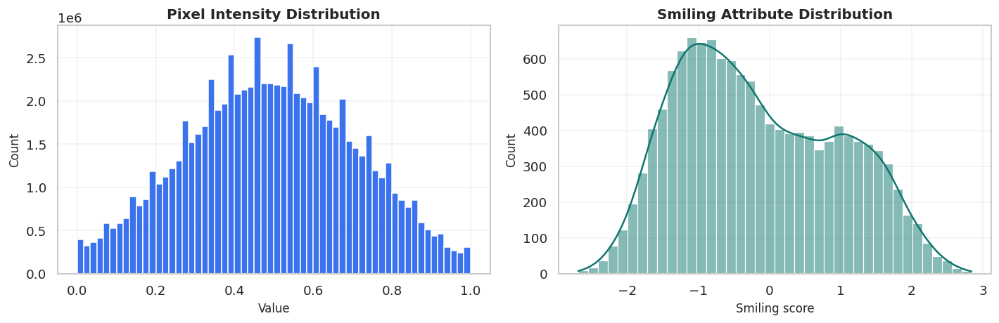

In [30]:
# Additional lightweight diagnostics
fig, axes = plt.subplots(1, 2, figsize=(12, 4))

axes[0].hist(data.ravel(), bins=60, color='#2563eb', alpha=0.9)
axes[0].set_title('Pixel Intensity Distribution')
axes[0].set_xlabel('Value')
axes[0].set_ylabel('Count')
axes[0].grid(alpha=0.25)

smile_score = attrs['Smiling'].astype(float)
sns.histplot(smile_score, bins=40, kde=True, ax=axes[1], color='#0f766e')
axes[1].set_title('Smiling Attribute Distribution')
axes[1].set_xlabel('Smiling score')
axes[1].grid(alpha=0.25)

plt.tight_layout()
plt.show()


### 6.1 Additional Computer Vision Diagnostics

To make preprocessing decisions more transparent, I added extra CV diagnostics:
- average-face visualization,
- edge structure analysis,
- CLAHE contrast inspection,
- smile-level behavior using edge density and sharpness trends.

These checks helped me verify that the processed data preserved useful structural cues.


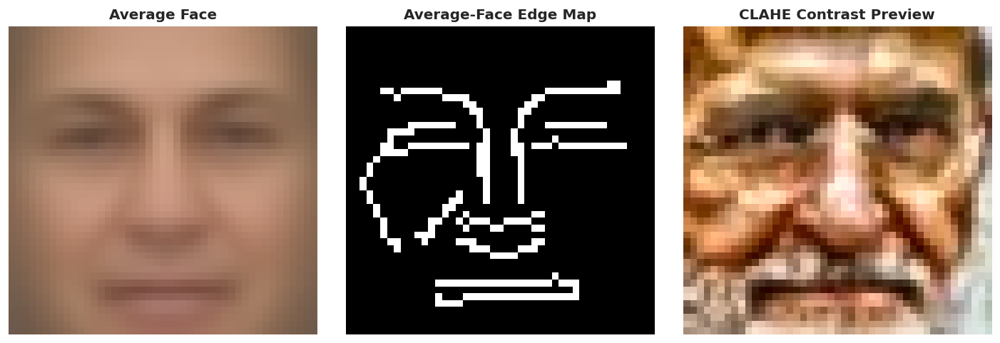

In [31]:
# Average face and edge structure
avg_face = data.mean(axis=0)
avg_u8 = (np.clip(avg_face, 0, 1) * 255).astype(np.uint8)
avg_edges = cv2.Canny(avg_u8, 50, 120)

# CLAHE preview for one random sample
sample_idx = np.random.randint(0, len(data))
sample_u8 = (np.clip(data[sample_idx], 0, 1) * 255).astype(np.uint8)
lab = cv2.cvtColor(sample_u8, cv2.COLOR_RGB2LAB)
l, a, b = cv2.split(lab)
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
l2 = clahe.apply(l)
clahe_img = cv2.cvtColor(cv2.merge([l2, a, b]), cv2.COLOR_LAB2RGB)

fig, axes = plt.subplots(1, 3, figsize=(12, 4))
axes[0].imshow(avg_face)
axes[0].set_title('Average Face')
axes[0].axis('off')
axes[1].imshow(avg_edges, cmap='gray')
axes[1].set_title('Average-Face Edge Map')
axes[1].axis('off')
axes[2].imshow(clahe_img)
axes[2].set_title('CLAHE Contrast Preview')
axes[2].axis('off')
plt.tight_layout()
plt.show()


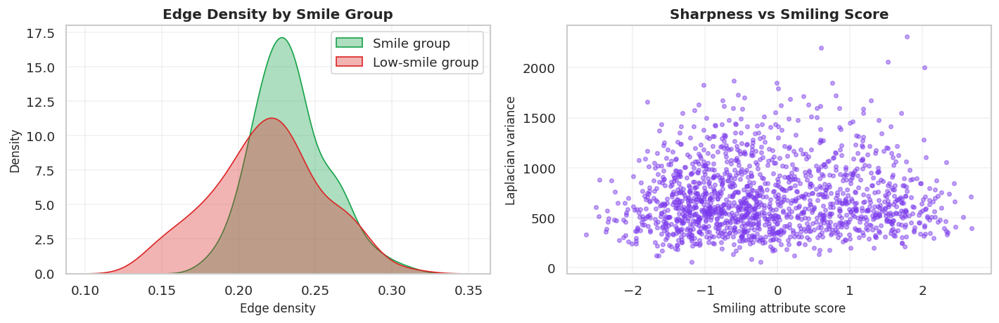

In [32]:
# Smile-related image statistics
smile_scores = attrs['Smiling'].astype(float)

hi_smile_idx = smile_scores.sort_values(ascending=False).iloc[100:250].index.values
lo_smile_idx = smile_scores.sort_values(ascending=True).head(150).index.values

def edge_density(img):
    gray = cv2.cvtColor((img * 255).astype(np.uint8), cv2.COLOR_RGB2GRAY)
    edges = cv2.Canny(gray, 60, 120)
    return edges.mean() / 255.0

def sharpness(img):
    gray = cv2.cvtColor((img * 255).astype(np.uint8), cv2.COLOR_RGB2GRAY)
    return cv2.Laplacian(gray, cv2.CV_64F).var()

hi_edge = [edge_density(data[i]) for i in hi_smile_idx[:120]]
lo_edge = [edge_density(data[i]) for i in lo_smile_idx[:120]]

fig, axes = plt.subplots(1, 2, figsize=(12, 4))
sns.kdeplot(hi_edge, label='Smile group', fill=True, alpha=0.35, ax=axes[0], color='#16a34a')
sns.kdeplot(lo_edge, label='Low-smile group', fill=True, alpha=0.35, ax=axes[0], color='#dc2626')
axes[0].set_title('Edge Density by Smile Group')
axes[0].set_xlabel('Edge density')
axes[0].grid(alpha=0.25)
axes[0].legend()

probe_idx = np.random.choice(len(data), size=min(1500, len(data)), replace=False)
probe_sharp = [sharpness(data[i]) for i in probe_idx]
probe_smile = smile_scores.iloc[probe_idx].values

axes[1].scatter(probe_smile, probe_sharp, s=11, alpha=0.45, color='#7c3aed')
axes[1].set_title('Sharpness vs Smiling Score')
axes[1].set_xlabel('Smiling attribute score')
axes[1].set_ylabel('Laplacian variance')
axes[1].grid(alpha=0.25)

plt.tight_layout()
plt.show()


## 7. Dense Autoencoder Architecture

In this section, I have used the dense autoencoder architecture :
- Encoder: `6075 -> 1500 -> 1000 -> 100`
- Decoder: `100 -> 1000 -> 1500 -> 6075`

I kept this architecture fixed throughout the notebook so I could analyze reconstruction quality and latent-editing behavior consistently.


In [33]:
dim_z = 100

class Autoencoder(nn.Module):
    def __init__(self):
        super().__init__()
        self.encoder = nn.Sequential(
            nn.Linear(45 * 45 * 3, 1500),
            nn.BatchNorm1d(1500),
            nn.ReLU(),
            nn.Linear(1500, 1000),
            nn.BatchNorm1d(1000),
            nn.ReLU(),
            nn.Linear(1000, dim_z),
            nn.BatchNorm1d(dim_z),
            nn.ReLU(),
        )
        self.decoder = nn.Sequential(
            nn.Linear(dim_z, 1000),
            nn.BatchNorm1d(1000),
            nn.ReLU(),
            nn.Linear(1000, 1500),
            nn.BatchNorm1d(1500),
            nn.ReLU(),
            nn.Linear(1500, 45 * 45 * 3),
        )

    def encode(self, x):
        return self.encoder(x)

    def decode(self, z):
        return self.decoder(z)

    def forward(self, x):
        encoded = self.encode(x)
        decoded = self.decode(encoded)
        return encoded, decoded

model_auto = Autoencoder().to(DEVICE)
model_auto


Autoencoder(
  (encoder): Sequential(
    (0): Linear(in_features=6075, out_features=1500, bias=True)
    (1): BatchNorm1d(1500, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Linear(in_features=1500, out_features=1000, bias=True)
    (4): BatchNorm1d(1000, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
    (6): Linear(in_features=1000, out_features=100, bias=True)
    (7): BatchNorm1d(100, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU()
  )
  (decoder): Sequential(
    (0): Linear(in_features=100, out_features=1000, bias=True)
    (1): BatchNorm1d(1000, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Linear(in_features=1000, out_features=1500, bias=True)
    (4): BatchNorm1d(1500, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
    (6): Linear(in_features=1500, out_features=6075, bias=True)
  )
)

## 8.1 Model Diagram and Training Objectives

![Dense Autoencoder Architecture](Dense_AE_Architecture.svg)

Before training, I presented the architecture diagram and explicitly documented the optimization objective used in this notebook.

- Optimization objective: **MSE reconstruction loss**
- Additional evaluation view: **SSIM-based quality analysis**


## 8. Training and Validation Protocol

I trained the model using the configuration I selected for this study:
- Optimizer: `Adam (lr=0.001)`
- Epochs: `50`
- Batch size: `64`

I also structured logs and plots so training dynamics and generalization behavior are easy to interpret.


epoch:   0%|          | 0/50 [00:00<?, ?it/s]

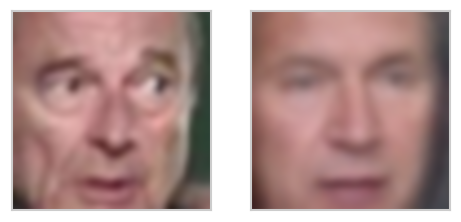

Epoch 001 | train: 0.0078 | val: 0.0059 | gap: -0.0019


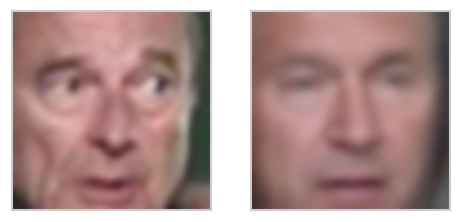

Epoch 002 | train: 0.0049 | val: 0.0058 | gap: 0.0009


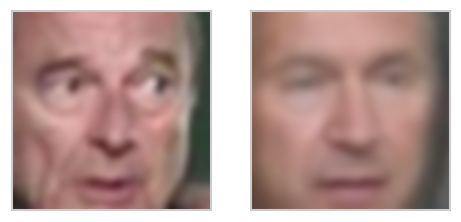

Epoch 003 | train: 0.0048 | val: 0.0059 | gap: 0.0011


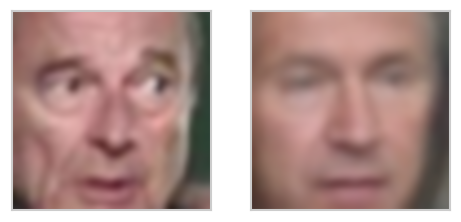

Epoch 004 | train: 0.0047 | val: 0.0060 | gap: 0.0013


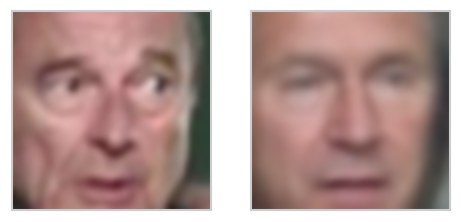

Epoch 005 | train: 0.0046 | val: 0.0060 | gap: 0.0014


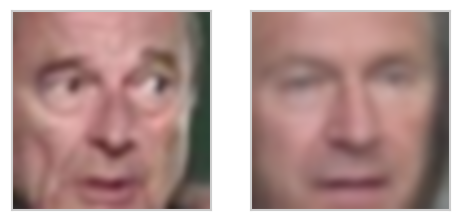

Epoch 006 | train: 0.0046 | val: 0.0062 | gap: 0.0016


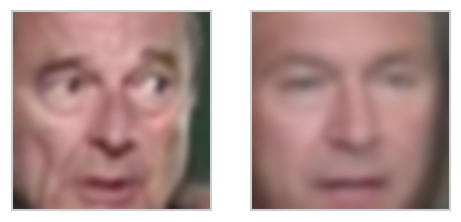

Epoch 007 | train: 0.0046 | val: 0.0060 | gap: 0.0015


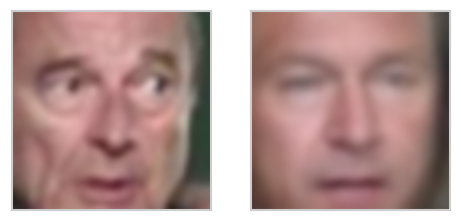

Epoch 008 | train: 0.0046 | val: 0.0062 | gap: 0.0016


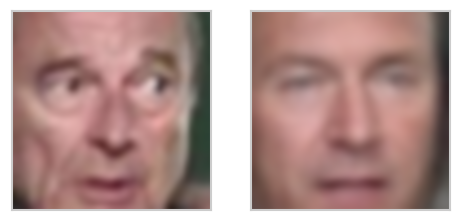

Epoch 009 | train: 0.0046 | val: 0.0060 | gap: 0.0014


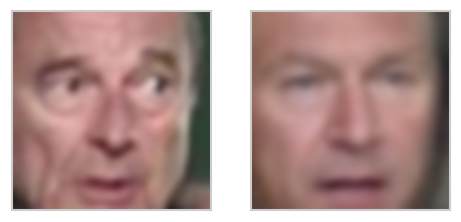

Epoch 010 | train: 0.0047 | val: 0.0064 | gap: 0.0017


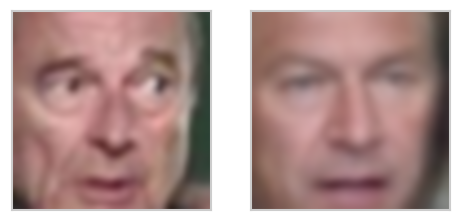

Epoch 011 | train: 0.0046 | val: 0.0060 | gap: 0.0015


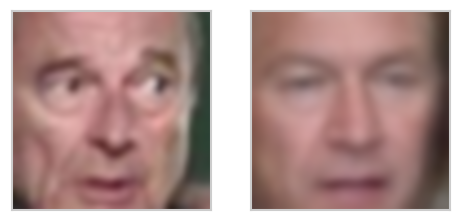

Epoch 012 | train: 0.0045 | val: 0.0063 | gap: 0.0018


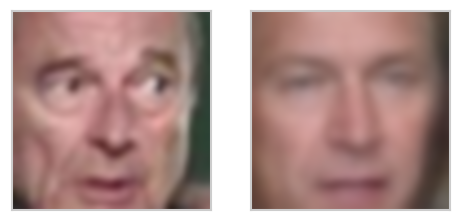

Epoch 013 | train: 0.0045 | val: 0.0062 | gap: 0.0018


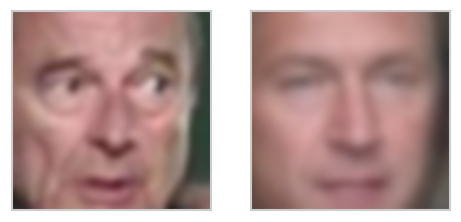

Epoch 014 | train: 0.0045 | val: 0.0065 | gap: 0.0020


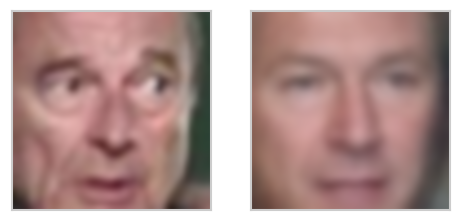

Epoch 015 | train: 0.0045 | val: 0.0061 | gap: 0.0016


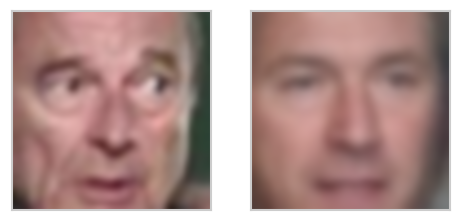

Epoch 016 | train: 0.0044 | val: 0.0062 | gap: 0.0018


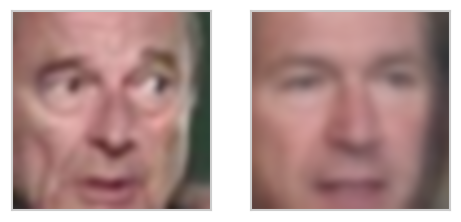

Epoch 017 | train: 0.0044 | val: 0.0062 | gap: 0.0018


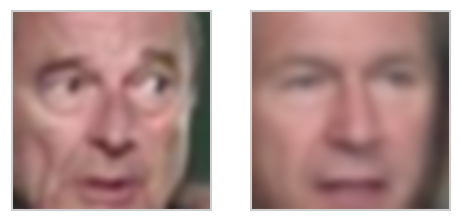

Epoch 018 | train: 0.0043 | val: 0.0062 | gap: 0.0019


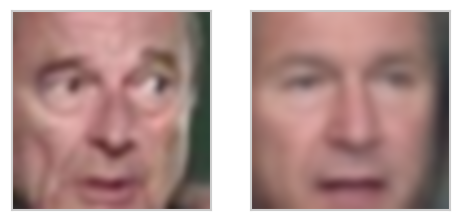

Epoch 019 | train: 0.0043 | val: 0.0061 | gap: 0.0018


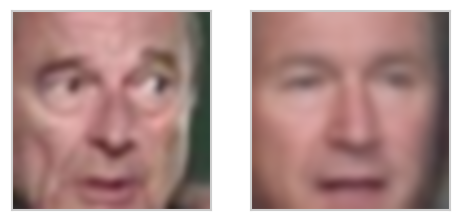

Epoch 020 | train: 0.0044 | val: 0.0062 | gap: 0.0019


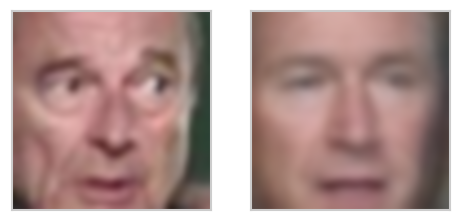

Epoch 021 | train: 0.0044 | val: 0.0066 | gap: 0.0022


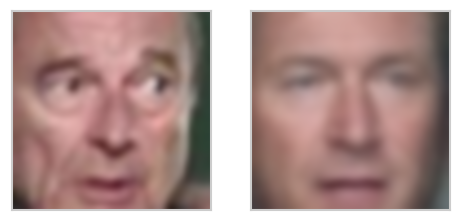

Epoch 022 | train: 0.0043 | val: 0.0064 | gap: 0.0021


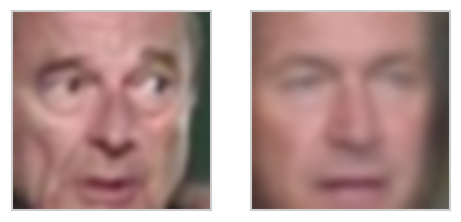

Epoch 023 | train: 0.0043 | val: 0.0066 | gap: 0.0022


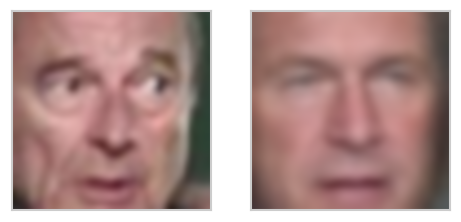

Epoch 024 | train: 0.0043 | val: 0.0066 | gap: 0.0023


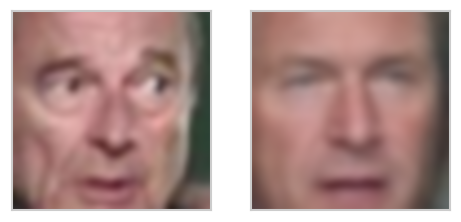

Epoch 025 | train: 0.0043 | val: 0.0066 | gap: 0.0023


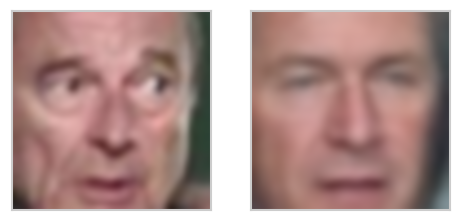

Epoch 026 | train: 0.0043 | val: 0.0065 | gap: 0.0023


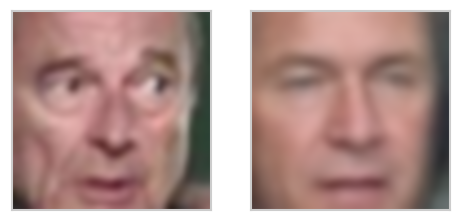

Epoch 027 | train: 0.0043 | val: 0.0067 | gap: 0.0024


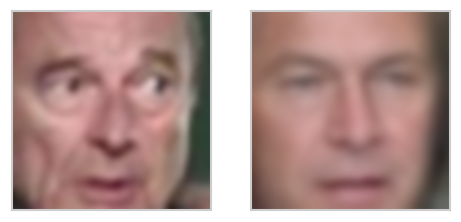

Epoch 028 | train: 0.0043 | val: 0.0066 | gap: 0.0023


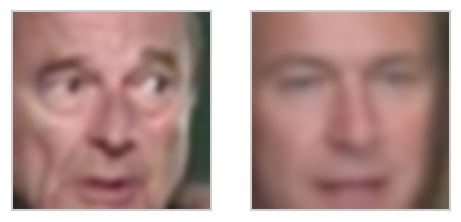

Epoch 029 | train: 0.0043 | val: 0.0072 | gap: 0.0029


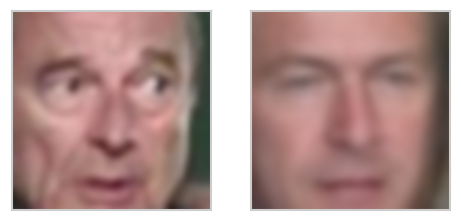

Epoch 030 | train: 0.0043 | val: 0.0068 | gap: 0.0025


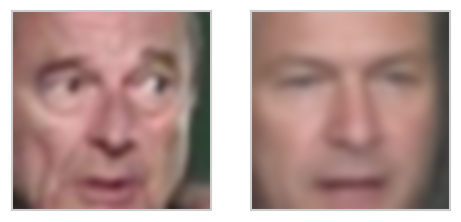

Epoch 031 | train: 0.0043 | val: 0.0064 | gap: 0.0021


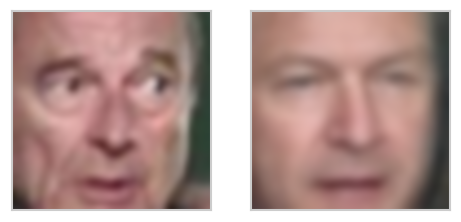

Epoch 032 | train: 0.0042 | val: 0.0076 | gap: 0.0034


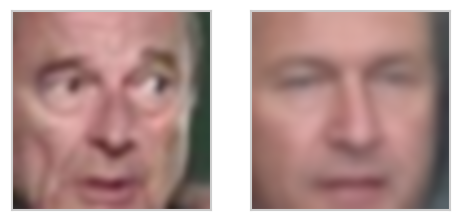

Epoch 033 | train: 0.0042 | val: 0.0071 | gap: 0.0029


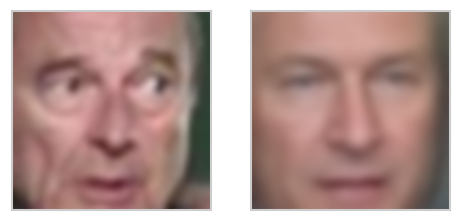

Epoch 034 | train: 0.0041 | val: 0.0067 | gap: 0.0026


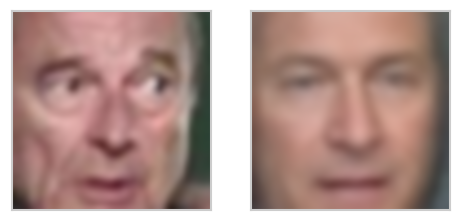

Epoch 035 | train: 0.0041 | val: 0.0067 | gap: 0.0026


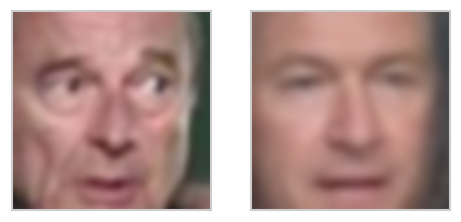

Epoch 036 | train: 0.0041 | val: 0.0065 | gap: 0.0024


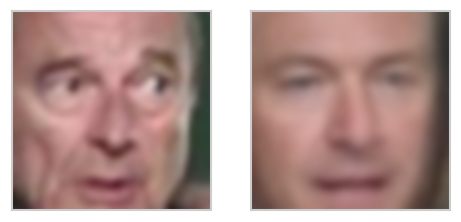

Epoch 037 | train: 0.0041 | val: 0.0066 | gap: 0.0025


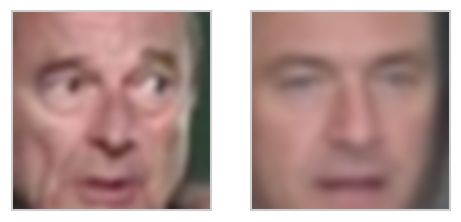

Epoch 038 | train: 0.0042 | val: 0.0067 | gap: 0.0025


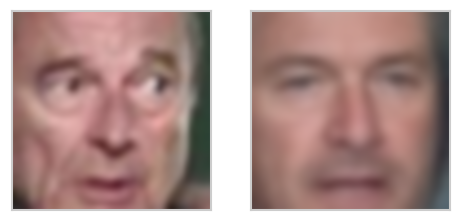

Epoch 039 | train: 0.0043 | val: 0.0077 | gap: 0.0034


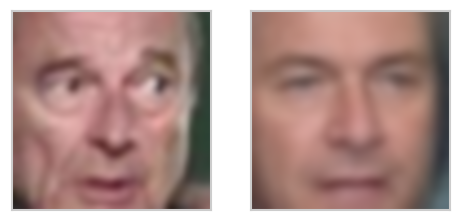

Epoch 040 | train: 0.0042 | val: 0.0069 | gap: 0.0027


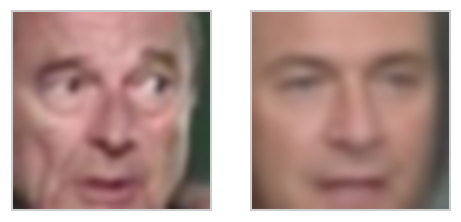

Epoch 041 | train: 0.0041 | val: 0.0067 | gap: 0.0025


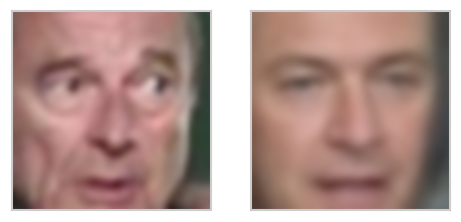

Epoch 042 | train: 0.0041 | val: 0.0068 | gap: 0.0027


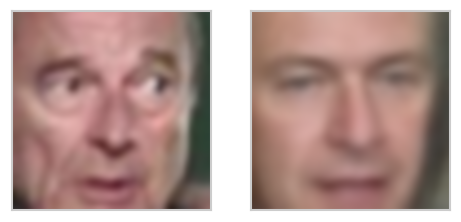

Epoch 043 | train: 0.0040 | val: 0.0066 | gap: 0.0026


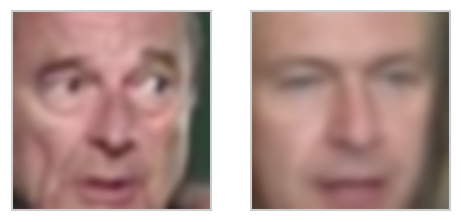

Epoch 044 | train: 0.0040 | val: 0.0067 | gap: 0.0028


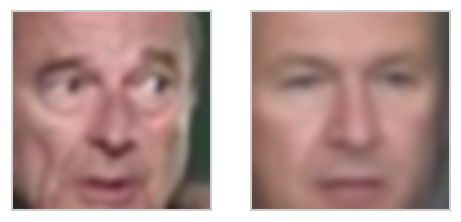

Epoch 045 | train: 0.0040 | val: 0.0068 | gap: 0.0028


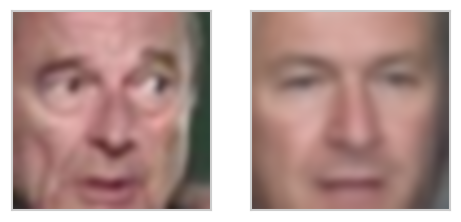

Epoch 046 | train: 0.0041 | val: 0.0069 | gap: 0.0028


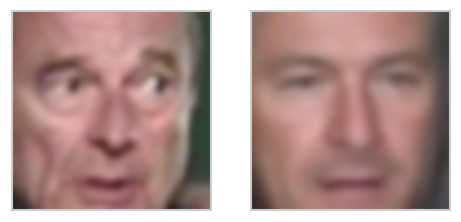

Epoch 047 | train: 0.0042 | val: 0.0069 | gap: 0.0028


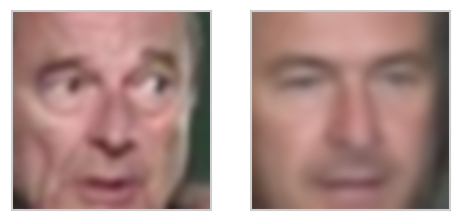

Epoch 048 | train: 0.0041 | val: 0.0071 | gap: 0.0030


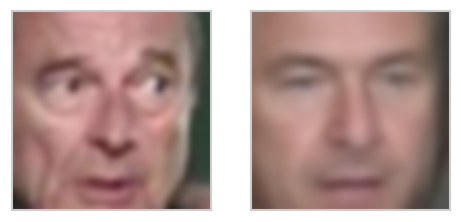

Epoch 049 | train: 0.0040 | val: 0.0068 | gap: 0.0029


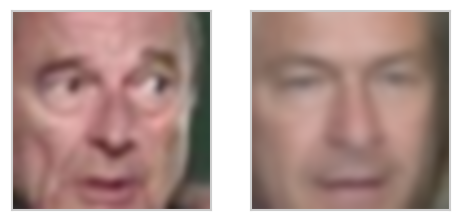

Epoch 050 | train: 0.0039 | val: 0.0072 | gap: 0.0033


In [36]:
def get_batch(data, batch_size=64):
    total_len = data.shape[0]
    for i in range(0, total_len, batch_size):
        yield data[i:min(i + batch_size, total_len)]


def plot_gallery(images, h, w, n_row=3, n_col=6, with_title=False, titles=[]):
    plt.figure(figsize=(1.9 * n_col, 2.0 * n_row))
    plt.subplots_adjust(bottom=0.02, left=0.02, right=.98, top=.93, hspace=.28)
    for i in range(n_row * n_col):
        plt.subplot(n_row, n_col, i + 1)
        try:
            img = np.array(images[i]).reshape((h, w, 3))
            plt.imshow(np.clip(img, 0, 1), interpolation='bicubic')
            if with_title and i < len(titles):
                plt.title(str(titles[i]), fontsize=8)
            plt.xticks(())
            plt.yticks(())
        except Exception:
            pass
    plt.show()


def fit_epoch(model, train_x, criterion, optimizer, batch_size):
    running_loss = 0.0
    processed_data = 0

    for inputs in get_batch(train_x, batch_size):
        inputs = inputs.view(-1, 45 * 45 * 3)
        inputs = inputs.to(DEVICE)

        optimizer.zero_grad()
        _, decoder = model(inputs)
        outputs = decoder.view(-1, 45 * 45 * 3)

        loss = criterion(outputs, inputs)
        loss.backward()
        optimizer.step()

        running_loss += loss.item() * inputs.shape[0]
        processed_data += inputs.shape[0]

    train_loss = running_loss / processed_data
    return train_loss


def eval_epoch(model, x_val, criterion):
    running_loss = 0.0
    processed_data = 0
    model.eval()

    for inputs in get_batch(x_val):
        inputs = inputs.view(-1, 45 * 45 * 3)
        inputs = inputs.to(DEVICE)

        with torch.set_grad_enabled(False):
            _, decoder = model(inputs)
            outputs = decoder.view(-1, 45 * 45 * 3)
            loss = criterion(outputs, inputs)
            running_loss += loss.item() * inputs.shape[0]
            processed_data += inputs.shape[0]

    val_loss = running_loss / processed_data

    # Small reconstruction preview each epoch
    with torch.set_grad_enabled(False):
        pic = x_val[10]
        pic_input = pic.view(-1, 45 * 45 * 3).to(DEVICE)
        _, decoder = model(pic_input)
        pic_output = decoder.view(-1, 45 * 45 * 3).squeeze().to('cpu')
        pic_input = pic_input.to('cpu')
        plot_gallery([pic_input, pic_output], 45, 45, 1, 2)

    return val_loss


def train(train_x, val_x, model, epochs=10, batch_size=32):
    criterion = nn.MSELoss()
    optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
    history = []

    with tqdm(desc='epoch', total=epochs) as pbar_outer:
        for epoch in range(epochs):
            train_loss = fit_epoch(model, train_x, criterion, optimizer, batch_size)
            val_loss = eval_epoch(model, val_x, criterion)

            history.append((train_loss, val_loss))
            pbar_outer.update(1)
            tqdm.write(f"Epoch {epoch+1:03d} | train: {train_loss:.4f} | val: {val_loss:.4f} | gap: {(val_loss-train_loss):.4f}")

    return history


history = train(X_train, X_val, model_auto, epochs=50, batch_size=64)


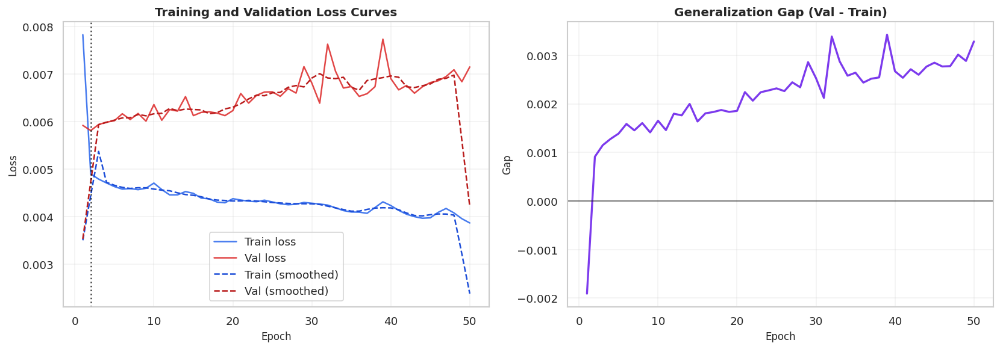

,epoch,train_loss,val_loss,gap
1,2,0.004902,0.005812,0.000911
0,1,0.007829,0.005922,-0.001907
2,3,0.004791,0.005940,0.001148
3,4,0.004710,0.005989,0.001279
8,9,0.004599,0.006011,0.001412
4,5,0.004634,0.006020,0.001387
10,11,0.004571,0.006030,0.001459
6,7,0.004591,0.006044,0.001453
18,19,0.004293,0.006127,0.001834
14,15,0.004491,0.006127,0.001636


In [37]:
train_loss, val_loss = zip(*history)
epochs = np.arange(1, len(train_loss) + 1)
train_arr = np.array(train_loss)
val_arr = np.array(val_loss)

def smooth_curve(arr, k=5):
    if len(arr) < k:
        return arr
    kernel = np.ones(k) / k
    return np.convolve(arr, kernel, mode='same')

best_epoch = int(np.argmin(val_arr)) + 1

fig, axes = plt.subplots(1, 2, figsize=(14, 5))
axes[0].plot(epochs, train_arr, label='Train loss', color='#2563eb', alpha=0.85)
axes[0].plot(epochs, val_arr, label='Val loss', color='#dc2626', alpha=0.85)
axes[0].plot(epochs, smooth_curve(train_arr), '--', color='#1d4ed8', label='Train (smoothed)')
axes[0].plot(epochs, smooth_curve(val_arr), '--', color='#b91c1c', label='Val (smoothed)')
axes[0].axvline(best_epoch, color='black', linestyle=':', alpha=0.7)
axes[0].set_title('Training and Validation Loss Curves')
axes[0].set_xlabel('Epoch')
axes[0].set_ylabel('Loss')
axes[0].legend()
axes[0].grid(alpha=0.25)

axes[1].plot(epochs, val_arr - train_arr, color='#7c3aed', lw=2)
axes[1].axhline(0, color='black', lw=1, alpha=0.6)
axes[1].set_title('Generalization Gap (Val - Train)')
axes[1].set_xlabel('Epoch')
axes[1].set_ylabel('Gap')
axes[1].grid(alpha=0.25)

plt.tight_layout()
plt.show()

summary_df = pd.DataFrame({'epoch': epochs, 'train_loss': train_arr, 'val_loss': val_arr})
summary_df['gap'] = summary_df['val_loss'] - summary_df['train_loss']
summary_df.sort_values('val_loss').head(10)


## 9. Reconstruction and Generation Results

After training, I evaluated the model with multiple complementary views:
- random latent generation,
- reconstruction comparisons,
- per-sample error maps,
- SSIM summaries.

This allowed me to assess both quantitative and qualitative reconstruction quality.


Latent sample shape: (25, 100)


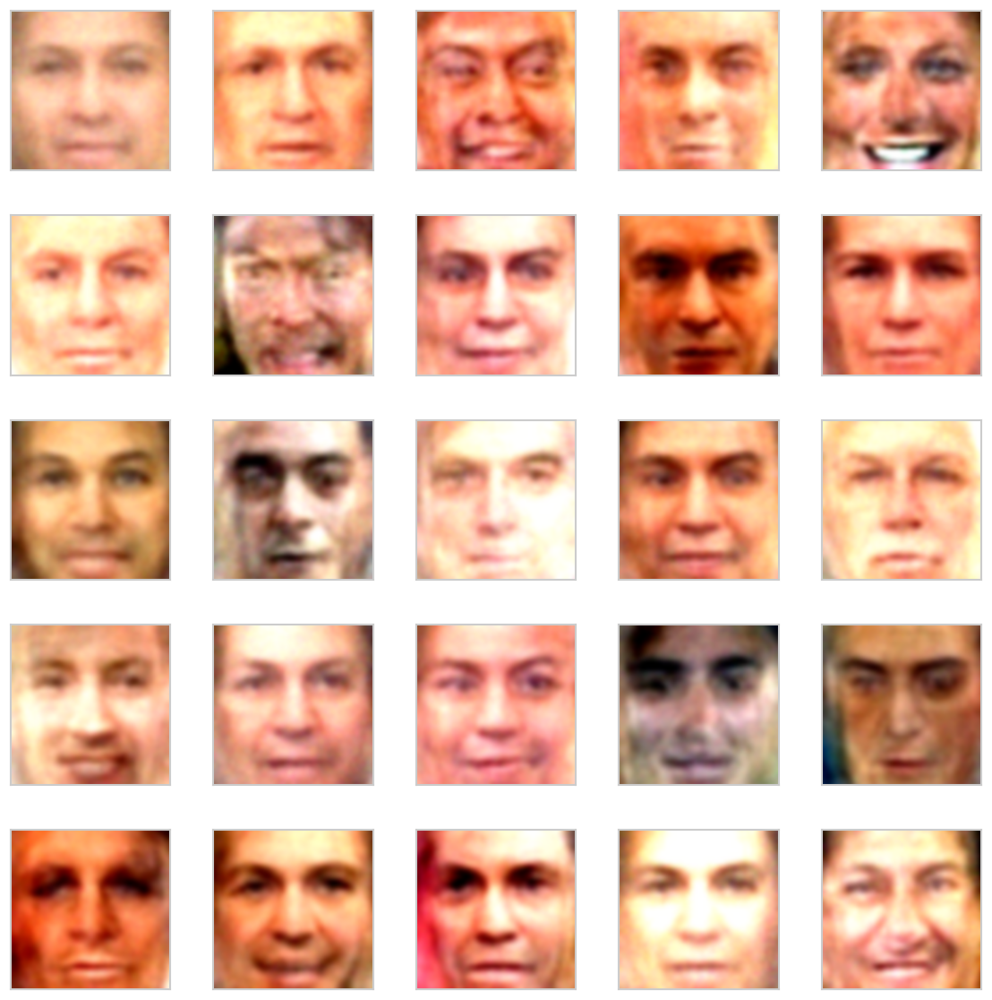

In [38]:
# Random latent sampling and face generation
z = np.random.randn(25, dim_z)
print('Latent sample shape:', z.shape)

with torch.no_grad():
    inputs = torch.FloatTensor(z).to(DEVICE)
    model_auto.eval()
    output = model_auto.decode(inputs).data.cpu().numpy()

plot_gallery(output, IMAGE_H, IMAGE_W, n_row=5, n_col=5)


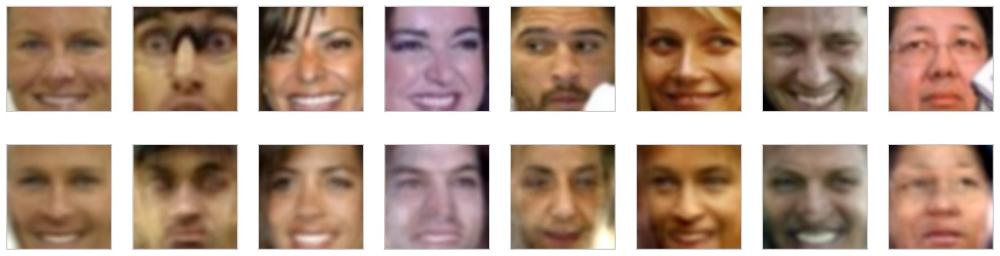

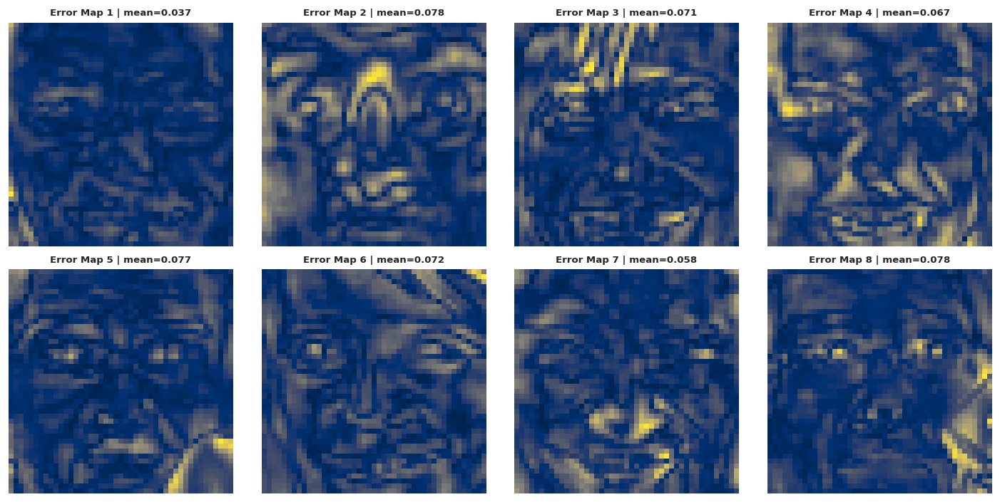

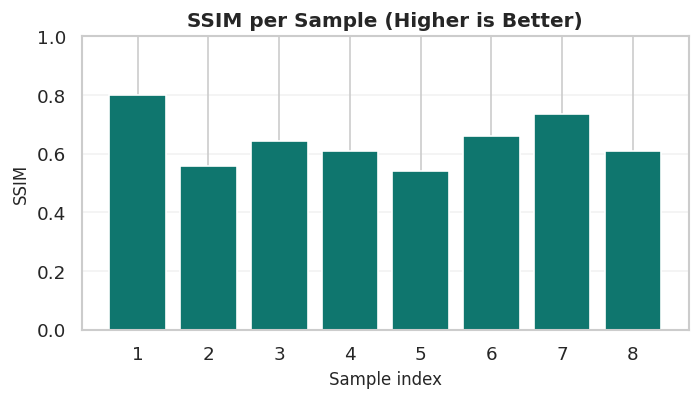

Mean SSIM (first 8 val samples): 0.6437


In [43]:
# Reconstruction diagnostics (with cividis error maps)
with torch.no_grad():
    model_auto.eval()
    recon_in = X_val[:8].view(-1, 45 * 45 * 3).to(DEVICE)
    _, recon_out = model_auto(recon_in)

orig = X_val[:8].numpy()
reco = recon_out.view(-1, 45, 45, 3).cpu().numpy()

# Top row original / bottom row reconstructed
comparison = np.concatenate([orig, reco], axis=0)
plot_gallery(comparison, IMAGE_H, IMAGE_W, n_row=2, n_col=8)

# Error maps
fig, axes = plt.subplots(2, 4, figsize=(12, 6))
errs = []
for i, ax in enumerate(axes.flatten()):
    err = np.abs(orig[i] - reco[i]).mean(axis=2)
    errs.append(float(err.mean()))
    ax.imshow(err, cmap='cividis')
    ax.set_title(f'Error Map {i+1} | mean={err.mean():.3f}', fontsize=8)
    ax.axis('off')
plt.tight_layout()
plt.show()

if HAS_SSIM:
    ssim_vals = []
    for i in range(len(orig)):
        s1 = cv2.cvtColor((orig[i] * 255).astype(np.uint8), cv2.COLOR_RGB2GRAY)
        s2 = cv2.cvtColor((reco[i] * 255).astype(np.uint8), cv2.COLOR_RGB2GRAY)
        ssim_vals.append(ssim(s1, s2, data_range=255))

    fig, ax = plt.subplots(1, 1, figsize=(6, 3.5))
    ax.bar(np.arange(1, len(ssim_vals) + 1), ssim_vals, color='#0f766e')
    ax.set_ylim(0, 1)
    ax.set_title('SSIM per Sample (Higher is Better)')
    ax.set_xlabel('Sample index')
    ax.set_ylabel('SSIM')
    ax.grid(axis='y', alpha=0.25)
    plt.tight_layout()
    plt.show()

    print('Mean SSIM (first 8 val samples):', round(float(np.mean(ssim_vals)), 4))


## 10. Attribute Buckets and Latent Editing

In this section, I grouped faces by attribute strength (smile / no-smile / eyeglasses / sunglasses), computed latent directions, and applied vector arithmetic for semantic edits.

This is where I demonstrate practical controllability of the learned latent space.


In [44]:
smile_ids = attrs['Smiling'].sort_values(ascending=False).iloc[100:125].index.values
smile_data = data[smile_ids]

no_smile_ids = attrs['Smiling'].sort_values(ascending=True).head(25).index.values
no_smile_data = data[no_smile_ids]

eyeglasses_ids = attrs['Eyeglasses'].sort_values(ascending=False).head(25).index.values
eyeglasses_data = data[eyeglasses_ids]

sunglasses_ids = attrs['Sunglasses'].sort_values(ascending=False).head(25).index.values
sunglasses_data = data[sunglasses_ids]



High Smile Faces


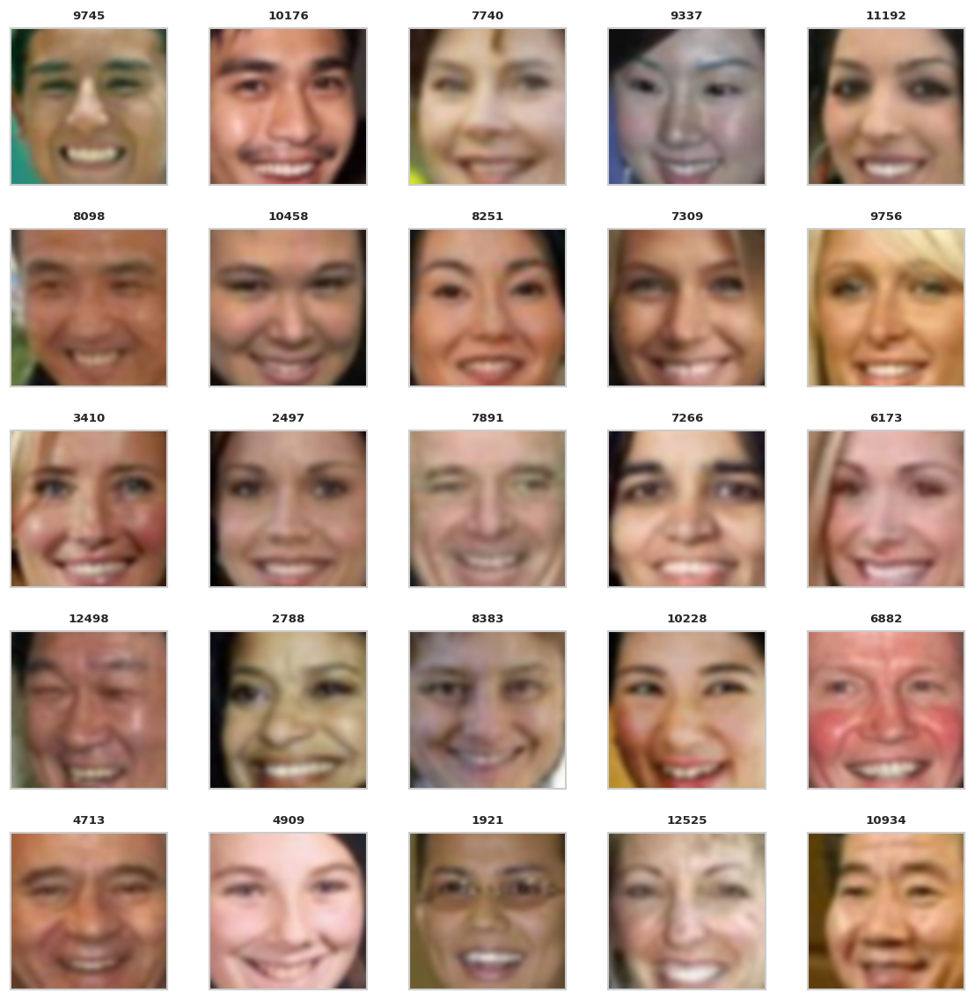


Low Smile Faces


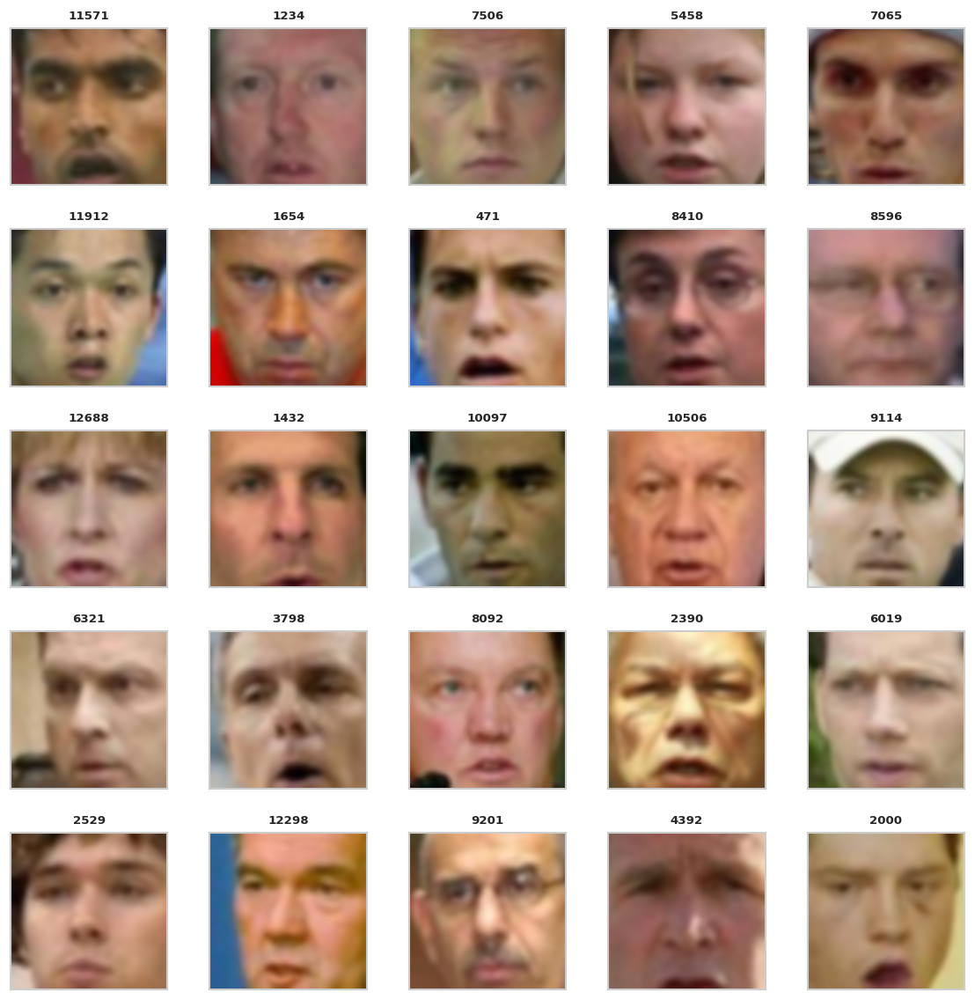


Eyeglasses Faces


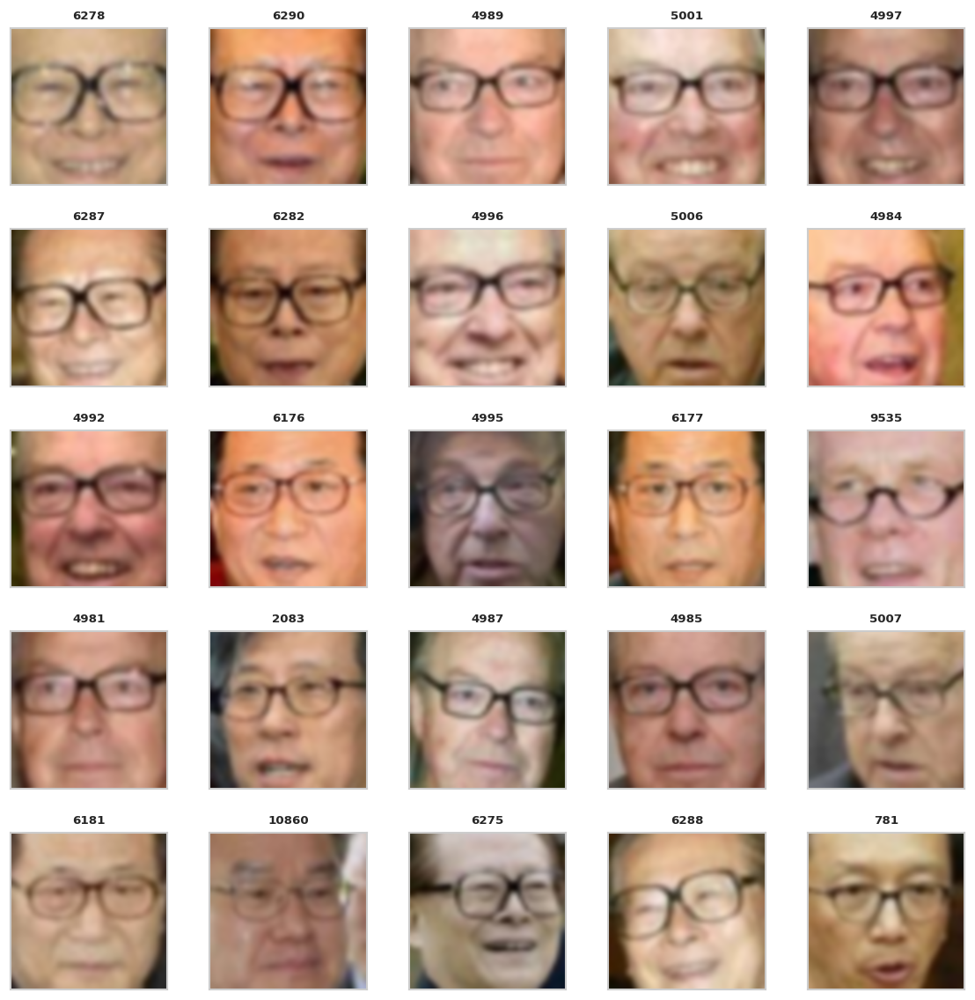


Sunglasses Faces


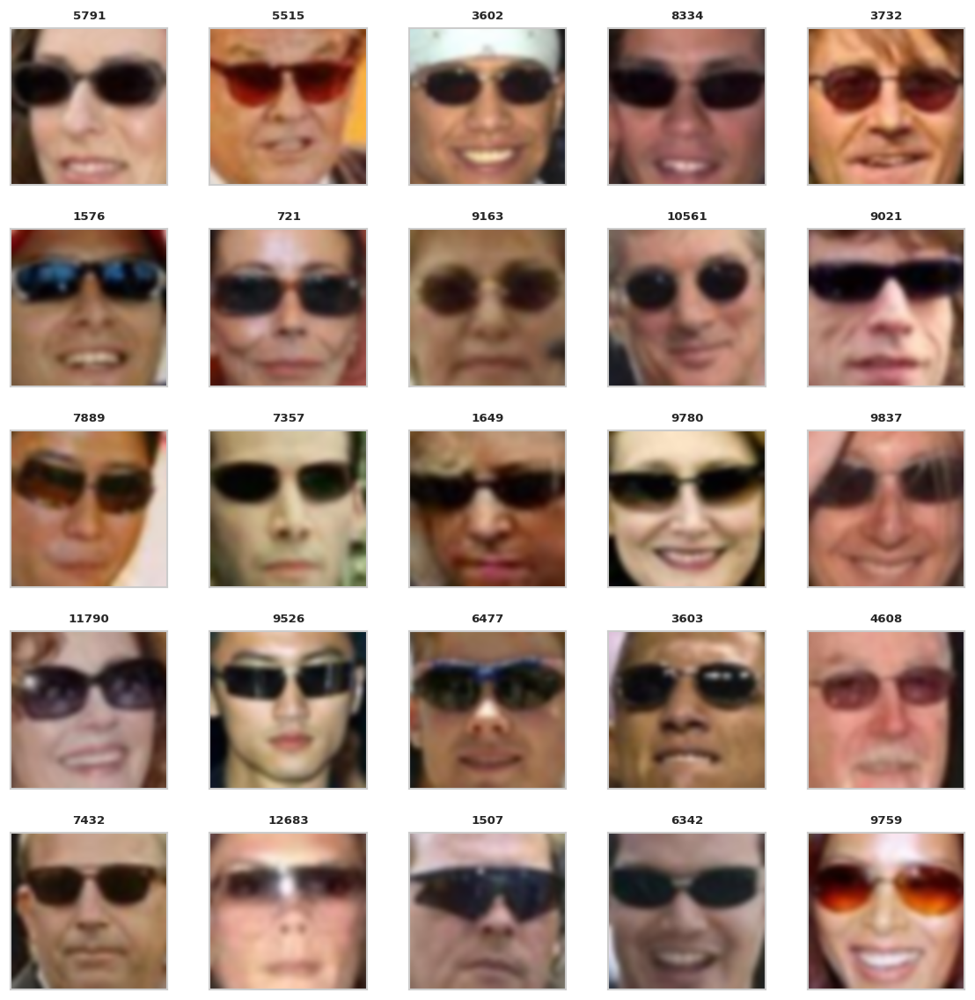

In [45]:
groups = [
    ('High Smile Faces', smile_data, smile_ids),
    ('Low Smile Faces', no_smile_data, no_smile_ids),
    ('Eyeglasses Faces', eyeglasses_data, eyeglasses_ids),
    ('Sunglasses Faces', sunglasses_data, sunglasses_ids),
]

for title, imgs, ids in groups:
    print(f"\n{title}")
    plot_gallery(imgs, IMAGE_H, IMAGE_W, n_row=5, n_col=5, with_title=True, titles=ids)


In [46]:
def to_latent(pic):
    with torch.no_grad():
        inputs = torch.FloatTensor(pic.reshape(-1, 45 * 45 * 3)).to(DEVICE)
        model_auto.eval()
        output = model_auto.encode(inputs)
        return output


def from_latent(vec):
    with torch.no_grad():
        inputs = vec.to(DEVICE)
        model_auto.eval()
        output = model_auto.decode(inputs)
        return output


smile_latent = to_latent(smile_data).mean(axis=0)
no_smile_latent = to_latent(no_smile_data).mean(axis=0)
sunglasses_latent = to_latent(sunglasses_data).mean(axis=0)

smile_vec = smile_latent - no_smile_latent
sunglasses_vec = sunglasses_latent - smile_latent


def make_me_smile(ids):
    for idx in ids:
        pic = data[idx:idx + 1]
        latent_vec = to_latent(pic)
        latent_vec[0] += smile_vec
        pic_output = from_latent(latent_vec)
        pic_output = pic_output.view(-1, 45, 45, 3).cpu()
        plot_gallery([pic, pic_output], IMAGE_H, IMAGE_W, n_row=1, n_col=2)


def give_me_sunglasses(ids):
    for idx in ids:
        pic = data[idx:idx + 1]
        latent_vec = to_latent(pic)
        latent_vec[0] += sunglasses_vec
        pic_output = from_latent(latent_vec)
        pic_output = pic_output.view(-1, 45, 45, 3).cpu()
        plot_gallery([pic, pic_output], IMAGE_H, IMAGE_W, n_row=1, n_col=2)


### 10.1 Latent-Space Visualization and Direction Analysis

To interpret what the model learned internally, I added:
- latent interpolation,
- PCA and t-SNE latent projections,
- classifier-derived latent direction comparison against mean-difference vectors.

These analyses helped me check whether edited directions are coherent and separable.


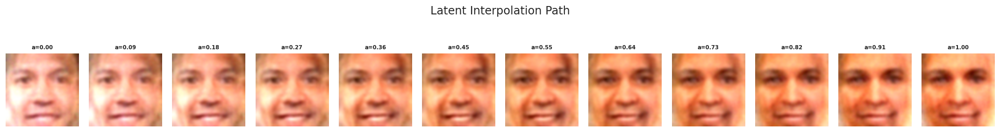

In [47]:
# Latent interpolation (decoder continuity check)
def latent_interpolation(steps=12):
    z1 = np.random.randn(dim_z)
    z2 = np.random.randn(dim_z)
    alphas = np.linspace(0, 1, steps)

    z_stack = np.array([(1 - a) * z1 + a * z2 for a in alphas], dtype=np.float32)
    with torch.no_grad():
        model_auto.eval()
        decoded = model_auto.decode(torch.FloatTensor(z_stack).to(DEVICE)).cpu().numpy()

    plt.figure(figsize=(18, 2.5))
    for i, (img, a) in enumerate(zip(decoded, alphas)):
        ax = plt.subplot(1, steps, i + 1)
        ax.imshow(np.clip(img.reshape(IMAGE_H, IMAGE_W, 3), 0, 1), interpolation='bicubic')
        ax.set_title(f"a={a:.2f}", fontsize=7)
        ax.axis('off')
    plt.suptitle('Latent Interpolation Path', y=1.03)
    plt.tight_layout()
    plt.show()

latent_interpolation(steps=12)


/usr/local/lib/python3.12/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(
/tmp/ipykernel_55/965833364.py:24: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


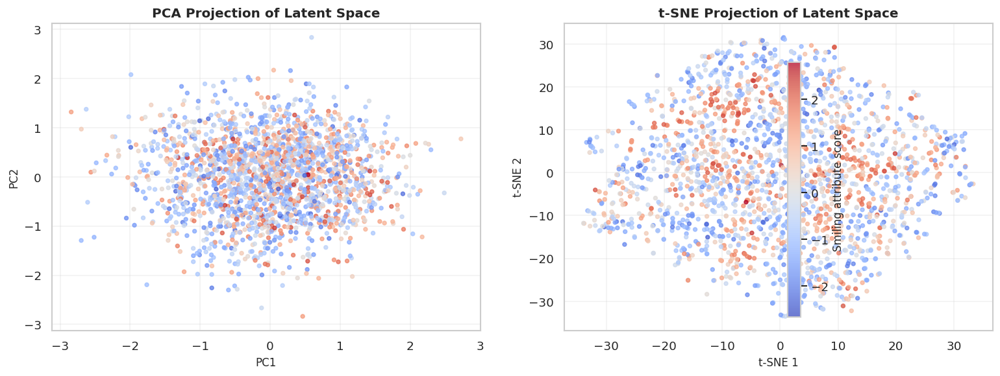

In [48]:
# PCA and t-SNE on latent vectors, colored by smiling score
viz_idx = np.random.choice(len(data), size=min(2000, len(data)), replace=False)
lat_viz = to_latent(data[viz_idx]).detach().cpu().numpy()
smile_viz = attrs.iloc[viz_idx]['Smiling'].astype(float).values

pca_2d = PCA(n_components=2, random_state=SEED).fit_transform(lat_viz)
tsne_2d = TSNE(n_components=2, perplexity=35, learning_rate='auto', init='pca', n_iter=500, random_state=SEED).fit_transform(lat_viz)

fig, axes = plt.subplots(1, 2, figsize=(13, 5))
sc0 = axes[0].scatter(pca_2d[:, 0], pca_2d[:, 1], c=smile_viz, cmap='coolwarm', s=12, alpha=0.75)
axes[0].set_title('PCA Projection of Latent Space')
axes[0].set_xlabel('PC1')
axes[0].set_ylabel('PC2')
axes[0].grid(alpha=0.25)

sc1 = axes[1].scatter(tsne_2d[:, 0], tsne_2d[:, 1], c=smile_viz, cmap='coolwarm', s=12, alpha=0.75)
axes[1].set_title('t-SNE Projection of Latent Space')
axes[1].set_xlabel('t-SNE 1')
axes[1].set_ylabel('t-SNE 2')
axes[1].grid(alpha=0.25)

cbar = fig.colorbar(sc1, ax=axes.ravel().tolist(), shrink=0.85)
cbar.set_label('Smiling attribute score')
plt.tight_layout()
plt.show()


Binary latent smile classifier accuracy: 0.9667
Cosine similarity (mean-diff vs classifier direction): 0.7979
Mean-difference smile edits


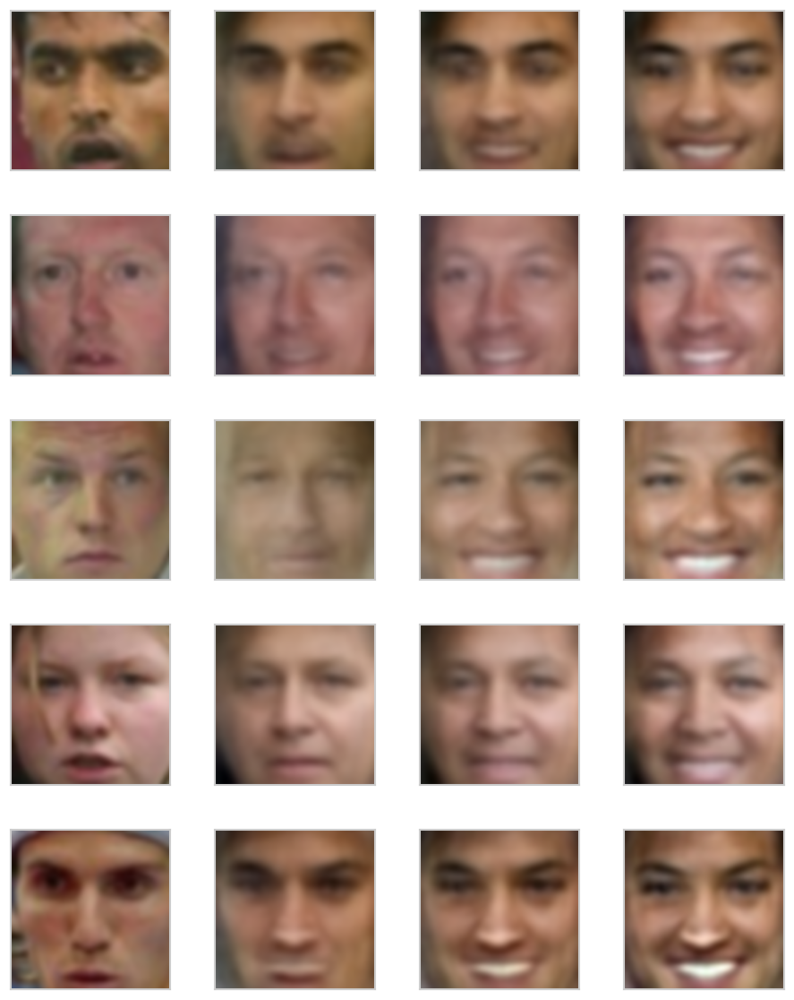

Classifier-direction smile edits


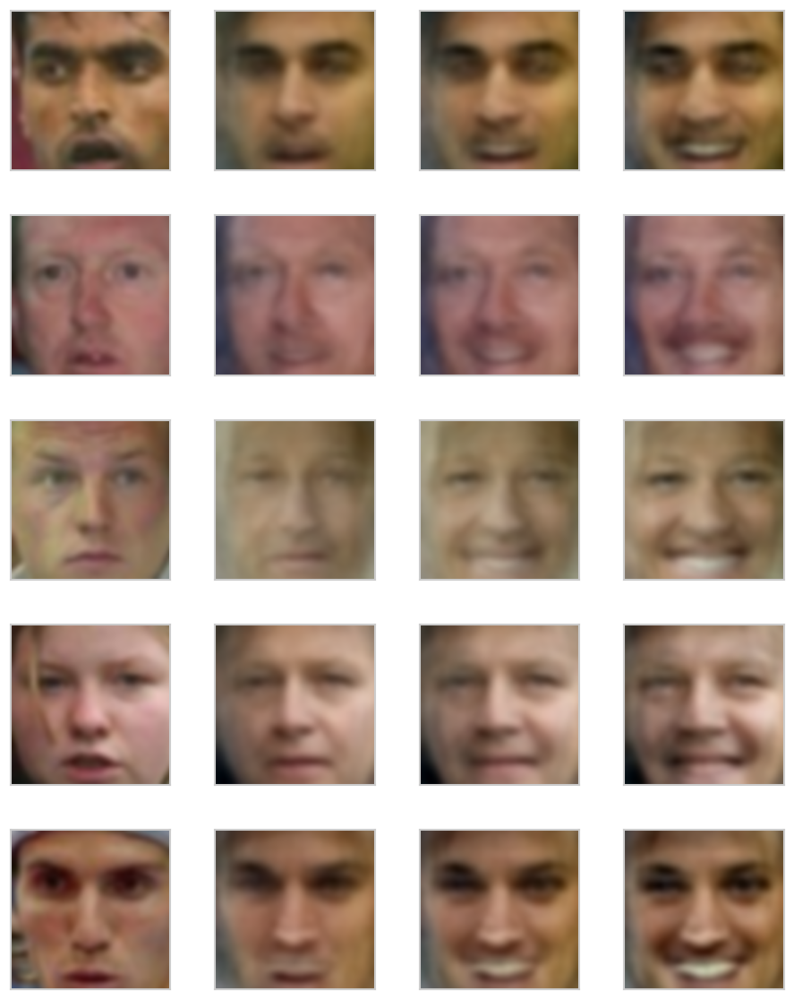

In [49]:
# Supervised smile direction (classifier-based) and comparison with mean-difference direction
clf_idx = np.random.choice(len(data), size=min(6000, len(data)), replace=False)
latent_subset = to_latent(data[clf_idx]).detach().cpu().numpy()
smile_subset = attrs.iloc[clf_idx]['Smiling'].astype(float).values

q_low, q_high = np.quantile(smile_subset, [0.25, 0.75])
mask = (smile_subset <= q_low) | (smile_subset >= q_high)
X_bin = latent_subset[mask]
y_bin = (smile_subset[mask] >= q_high).astype(int)

clf = LogisticRegression(max_iter=2000)
clf.fit(X_bin, y_bin)
clf_vec = clf.coef_.ravel()
clf_vec = clf_vec / (np.linalg.norm(clf_vec) + 1e-8)

smile_vec_np = smile_vec.detach().cpu().numpy()
smile_vec_np = smile_vec_np / (np.linalg.norm(smile_vec_np) + 1e-8)
cos_sim = float(np.dot(smile_vec_np, clf_vec))

print('Binary latent smile classifier accuracy:', round(float(clf.score(X_bin, y_bin)), 4))
print('Cosine similarity (mean-diff vs classifier direction):', round(cos_sim, 4))

clf_vec_t = torch.FloatTensor(clf_vec).to(DEVICE)

def show_edit_panel(ids, alphas, direction_tensor, title):
    imgs = []
    for idx in ids:
        pic = data[idx:idx+1]
        latent_vec = to_latent(pic)
        row = [pic[0]]
        for a in alphas[1:]:
            edited = from_latent(latent_vec + a * direction_tensor)
            row.append(edited.view(-1, 45, 45, 3).cpu().numpy()[0])
        imgs.extend(row)

    print(title)
    plot_gallery(imgs, IMAGE_H, IMAGE_W, n_row=len(ids), n_col=len(alphas))

show_edit_panel(no_smile_ids[:5], (0.0, 0.5, 1.0, 1.5), smile_vec, 'Mean-difference smile edits')
show_edit_panel(no_smile_ids[:5], (0.0, 0.6, 1.2, 1.8), clf_vec_t, 'Classifier-direction smile edits')


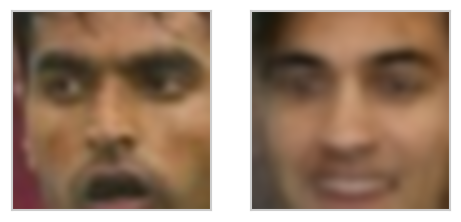

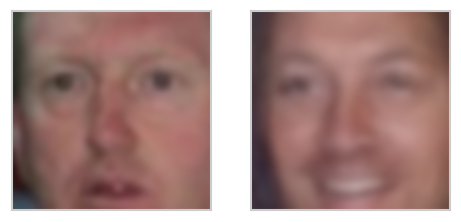

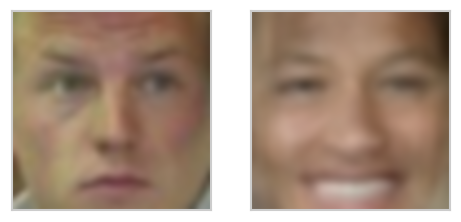

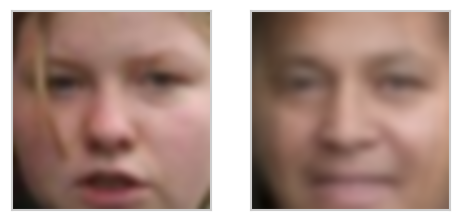

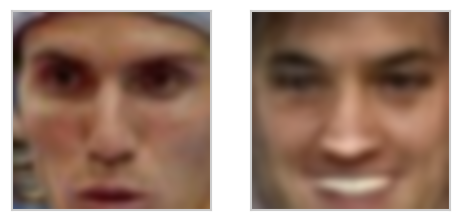

...

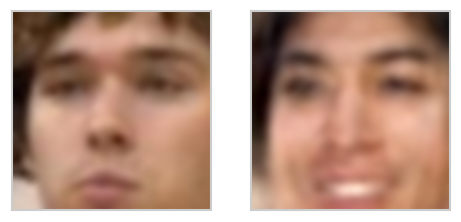

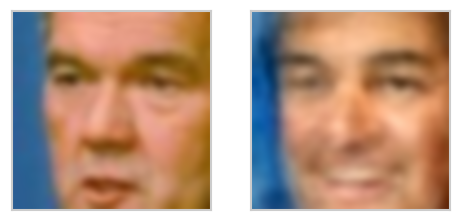

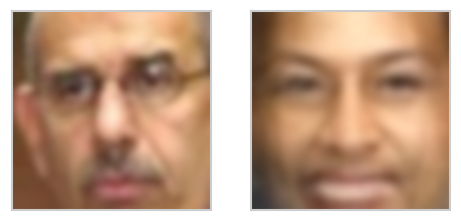

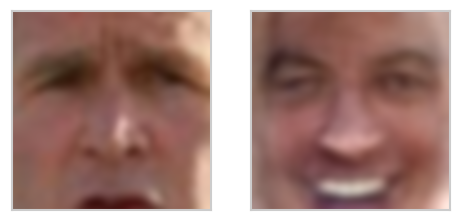

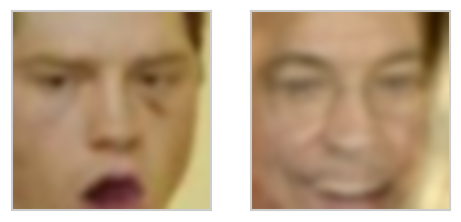

In [50]:
make_me_smile(no_smile_ids)


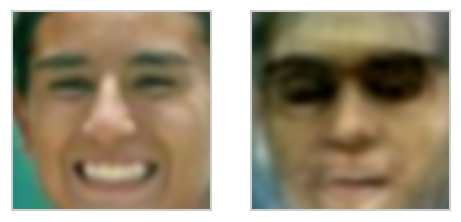

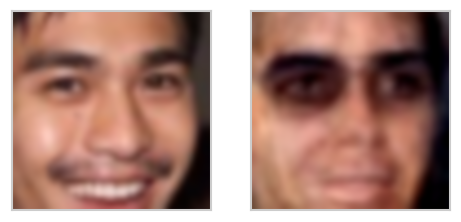

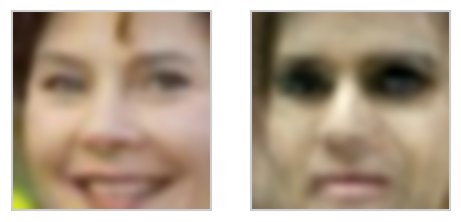

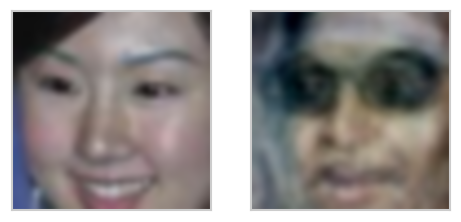

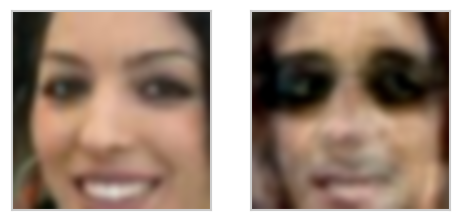

...

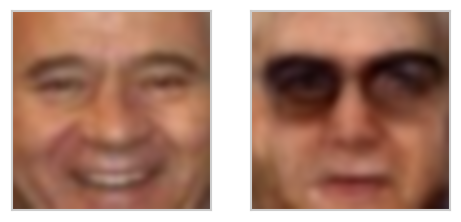

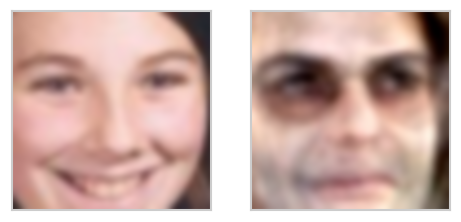

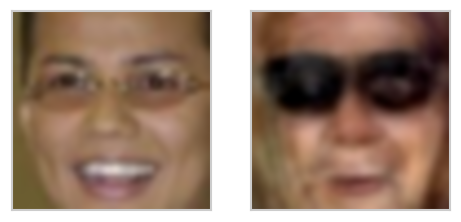

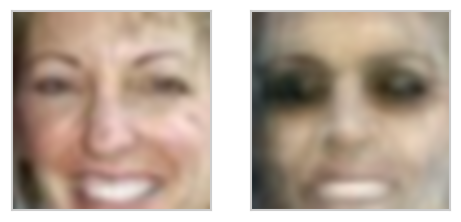

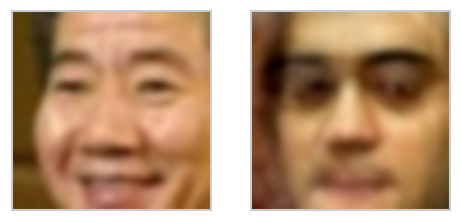

In [51]:
give_me_sunglasses(smile_ids)


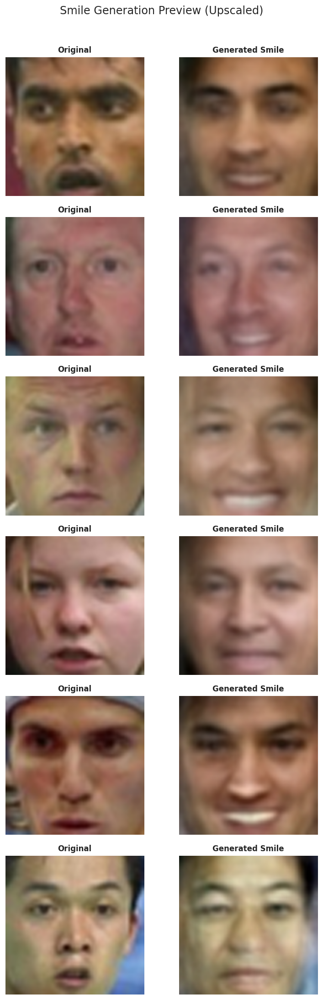

In [52]:
# Extra helper preview (optional): smoother display for generated smiles

def show_smile_preview(sample_ids, out_size=200):
    rows = []
    for idx in sample_ids:
        pic = data[idx:idx + 1]
        latent_vec = to_latent(pic)
        latent_vec[0] += smile_vec
        pic_output = from_latent(latent_vec).view(-1, 45, 45, 3).cpu().numpy()[0]

        base_u8 = (np.clip(pic[0], 0, 1) * 255).astype(np.uint8)
        edit_u8 = (np.clip(pic_output, 0, 1) * 255).astype(np.uint8)

        base_big = cv2.resize(base_u8, (out_size, out_size), interpolation=cv2.INTER_CUBIC)
        edit_big = cv2.resize(edit_u8, (out_size, out_size), interpolation=cv2.INTER_CUBIC)
        rows.append((base_big, edit_big))

    fig, axes = plt.subplots(len(rows), 2, figsize=(7, 3.0 * len(rows)))
    if len(rows) == 1:
        axes = np.array([axes])

    for i, (b, e) in enumerate(rows):
        axes[i, 0].imshow(b)
        axes[i, 0].set_title('Original', fontsize=10)
        axes[i, 0].axis('off')

        axes[i, 1].imshow(e)
        axes[i, 1].set_title('Generated Smile', fontsize=10)
        axes[i, 1].axis('off')

    plt.suptitle('Smile Generation Preview (Upscaled)', y=1.01)
    plt.tight_layout()
    plt.show()

show_smile_preview(no_smile_ids[:6], out_size=200)


## 11. Implementation Summary

In summary, I implemented a complete face-generation and latent-editing workflow with:
- structured EDA and attribute-aware preprocessing,
- dense autoencoder training,
- reconstruction diagnostics,
- semantic latent editing,
- and advanced latent-space interpretability analysis.


## 12. Critical Q&A and Extension Path

I closed the notebook with critical discussion points to justify model choices and highlight realistic extensions.

- why this setup works for controlled latent editing,
- when VAE-style regularization may be preferable,
- what future upgrades (e.g., convolutional encoders, identity-preservation metrics, disentanglement constraints) can improve robustness.
